# Analysis of Housing Prices
<br> 
This analysis was conducted using a dataset of Melbourne housing prices. The dataset can be found here https://www.kaggle.com/anthonypino/melbourne-housing-market

<br>
<br>
the Following steps will be taken 
<li> 1. Deal with missing data 
<li>2. Handle Outliers
<li>3. Peform Rigouroius EDA
<li>4. Calculate  prediction error from OLS regression 
<li>5. See how much we can improve our predcitions using machine learning
<li>6. Trim unnecessary variables to optimize ML


<h3> handle imports
    

In [29]:
import pandas as pd
import numpy as np
# import plotly as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from scipy import stats


from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

import csv
import statsmodels.api as sm

import matplotlib.pyplot as plt
import seaborn as sns 
# % matplotlib inline


import warnings
warnings.filterwarnings('ignore')
init_notebook_mode(connected=True)

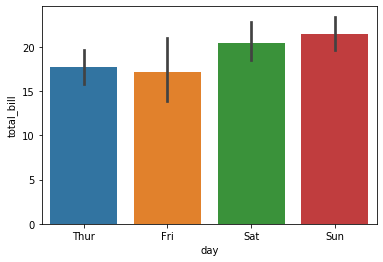

In [30]:
tips = sns.load_dataset("tips")
ax = sns.barplot(x="day", y="total_bill", data=tips)

In [3]:
df = pd.read_csv("melbourneHousing.csv" )
colz = df.columns
colz = [name.lower().replace("2", "").replace("lattitude","latitude").replace("longtitude","longitude")
        for name in colz]

df.columns = colz
df.head()

,suburb,address,rooms,type,price,method,sellerg,date,distance,postcode,...,bathroom,car,landsize,buildingarea,yearbuilt,councilarea,latitude,longitude,regionname,propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


# Handle Missing Data

In [4]:
def missingPct(col):
    
    return (1-len(df[col].dropna())/len(df))*100

def dataType(col):
    return str(df[col].dtypes)

def findMean(col):
    droppedNans = df[col].dropna()
    firstValue =list(droppedNans)[1]
    
    if (type(firstValue)) in [float, int]:

        return droppedNans.mean()
    else:
        return 'String Col'
    
def findStd(col):
    droppedNans = df[col].dropna()
    firstValue =list(droppedNans)[1]

    if (type(firstValue)) in [float, int]:

        return droppedNans.std()
    else:
        return 'String Col'

def createDataTable():
    
    missingRow = [missingPct(col) for col in colz]
    typeRow = [dataType(col) for col in colz]
    meanRow =  [findMean(col) for col in colz]
    stdRow =  [findStd(col) for col in colz]

    dataTable = df.head(0)

    for row in  [missingRow, typeRow, meanRow, stdRow]:
        dataTable.loc[len(dataTable.index)] = row

    dataTable = dataTable.transpose()
    dataTable.columns = ['Pct Missing', 'Data Type', 'Mean', 'STD']

    return dataTable

createDataTable()

,Pct Missing,Data Type,Mean,STD
suburb,0,object,String Col,String Col
address,0,object,String Col,String Col
rooms,0,int64,3.03101,0.969933
type,0,object,String Col,String Col
price,21.8321,float64,1.05017e+06,641467
method,0,object,String Col,String Col
sellerg,0,object,String Col,String Col
date,0,object,String Col,String Col
distance,0.00286886,float64,11.1849,6.78889
postcode,0.00286886,float64,3116.06,109.024


Price is missing 22% of its values, this could be imputed but its our independent variable
<br></br>

Looks like there's a lot of data missing in this dataset. The "Building Area" and "Year Built" variables have more data missing than not, they're obvious candidates to drop. 
<br></br>
<br></br>
Also of note, council area, regionname, and property count have the same low percentage of missing variables. Likely the same rows which can probably be cut as they represent such a small portion of the dataset. 

In [5]:
df.dropna(subset=['councilarea'], inplace=True)

there is also a lot of missing data from geographical columns. Lets fill this data with the mean of the most specific geographical column (the column with the most uniquie values)

In [6]:
geoColz = ['postcode',
'regionname',
'councilarea',
'suburb']

counts = []
for col in geoColz: 
    series = list(df[col].value_counts().index)
    counts.append(len(series))
countDf = pd.DataFrame(columns = ['Col', 'Count_Unique'])
countDf.Col =geoColz
countDf.Count_Unique = counts
countDf.sort_values(by='Count_Unique', ascending=False)


,Col,Count_Unique
3,suburb,350
0,postcode,211
2,councilarea,33
1,regionname,8


<br></br>
There you have it, there are more unique suburbs than any other geographical column. For latitude, longitude, and landsize, lets fill nulls with the average value by suburb for each variable

<br></br>

In [7]:
def fillConinuousUsingSuburb(col):
    valueBySuburb = dict(df.groupby('suburb').mean()[col])
    colList= list(df[col])
    suburbList  = list(df.suburb)
    
    rezList = []
    for ind, value in enumerate(colList):
        if np.isnan(value):
            currentSuburb  = suburbList[ind]
            suburbMean = valueBySuburb[currentSuburb]
            rezList.append(suburbMean)
        else: 
            rezList.append(value)
    return rezList

In [8]:

for col in ['longitude','latitude', 'landsize']:
    df[col] = fillConinuousUsingSuburb(col)
df.head()

,suburb,address,rooms,type,price,method,sellerg,date,distance,postcode,...,bathroom,car,landsize,buildingarea,yearbuilt,councilarea,latitude,longitude,regionname,propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [9]:
df.columns

Index(['suburb', 'address', 'rooms', 'type', 'price', 'method', 'sellerg',
       'date', 'distance', 'postcode', 'bedroom', 'bathroom', 'car',
       'landsize', 'buildingarea', 'yearbuilt', 'councilarea', 'latitude',
       'longitude', 'regionname', 'propertycount'],
      dtype='object')

In [10]:
for col in ['car','bedroom','bathroom']:
    df[col].fillna(value=df[col].mean(), inplace=True)

In [11]:
df[df.isnull().any(axis=1)]

,suburb,address,rooms,type,price,method,sellerg,date,distance,postcode,...,bathroom,car,landsize,buildingarea,yearbuilt,councilarea,latitude,longitude,regionname,propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.000000,1.000000,126.000000,NaN,NaN,Yarra City Council,-37.801400,144.995800,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.000000,1.000000,202.000000,NaN,NaN,Yarra City Council,-37.799600,144.998400,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.000000,1.000000,0.000000,NaN,NaN,Yarra City Council,-37.811400,145.011600,Northern Metropolitan,4019.0
5,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.000000,1.000000,94.000000,NaN,NaN,Yarra City Council,-37.796900,144.996900,Northern Metropolitan,4019.0
7,Abbotsford,16 Maugie St,4,h,NaN,SN,Nelson,6/08/2016,2.5,3067.0,...,2.000000,2.000000,400.000000,220.0,2006.0,Yarra City Council,-37.796500,144.996500,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34848,Wollert,16 Gunther Wy,4,h,621000.0,S,hockingstuart,24/02/2018,25.5,3750.0,...,2.000000,2.000000,375.000000,NaN,NaN,Whittlesea City Council,-37.613310,145.034120,Northern Metropolitan,2940.0
34850,Wollert,15 Rockgarden Wy,3,h,NaN,SP,LJ,24/02/2018,25.5,3750.0,...,2.000000,2.000000,268.000000,135.0,2016.0,Whittlesea City Council,-37.610940,145.042810,Northern Metropolitan,2940.0
34851,Yarraville,78 Bayview Rd,3,h,1101000.0,S,Jas,24/02/2018,6.3,3013.0,...,1.000000,1.728845,288.000000,NaN,NaN,Maribyrnong City Council,-37.810950,144.885160,Western Metropolitan,6543.0
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,...,1.000000,3.000000,593.000000,NaN,NaN,Maribyrnong City Council,-37.810530,144.884670,Western Metropolitan,6543.0


# Removing Outliers
<br></br>
lets identify and remove homes that have a z score of more than 3 for selected continuous variables

In [13]:
def dropMinValues(col, filtValue):
    indexList = list(df[df[col]<=filtValue].index)
    for val in indexList:
       df.drop(index=val, inplace=True)
    

def dropMaxValues(col, filtValue):
    indexList = list(df[df[col]>=filtValue].index)
    for val in indexList:
         df.drop(index=val, inplace=True)
        
        
def removeOutliers(col):
    temp = df
    colMean = df[col].mean()
    colStd= df[col].std()
    temp['z']=[abs((el-colMean)/colStd) for el in list(df[col])]
    indexList = list(temp[temp['z']>=3].index)
    for val in indexList:
         df.drop(index=val, inplace=True)


In [19]:
test = pd.DataFrame(df['type'].value_counts())
test.reset_index(inplace=True)
test.columns=['type','count']
test

,type,count
0,h,23978
1,u,7296
2,t,3580


In [27]:
data=[go.Bar(
x=list(test.type),
y=list(test['count']))]

# layout = go.Layout(title="Returns Beyond S&P 500",
#                    yaxis=dict(title='Returns', 
#                              tickformat='%')
#                   )

fig = go.Figure(data=data)
iplot(fig)

In [16]:
fig = go.Figure()
fig.add_trace(go.Box(y=list(df["yearbuilt"])))
iplot(fig)

In [13]:
fig = px.box(df, y="yearbuilt")
iplot(fig)

In [40]:
dropMinValues("yearbuilt", 1200)

In [41]:

removeOutliers("yearbuilt")

In [42]:
fig = px.box(df, y="buildingarea")
iplot(fig)

In [43]:
# dropMaxValues("buildingarea",2000)

removeOutliers("buildingarea")

In [44]:
fig = px.box(df, y="bedroom")
iplot(fig)

In [45]:
dropMaxValues("bedroom",10)

In [46]:
fig = px.box(df, y="price")
iplot(fig)

In [47]:
dropMaxValues("price",9000000)

In [48]:
print("we still have " + str(len(df)) + " rows, plenty of data to work with")

we still have 34824 rows, plenty of data to work with


In [49]:
df.drop(['z'], axis=1, inplace=True)

# Create Scatter Matrix

In [50]:
df['logprice'] = np.log(df.price)

# df.head()

In [51]:
fig = px.histogram(df, x="logprice", nbins=20)
iplot(fig)

In [52]:
df.type.value_counts()

h    23955
u     7291
t     3578
Name: type, dtype: int64

In [53]:

continuousVars = [
 'price',
 'distance',
 'postcode',
 'latitude',
 'longitude',
 'propertycount'
]




fig = px.scatter_matrix(df[continuousVars])
iplot(fig)

In [54]:
categoricalVars =[
     'price',
 'rooms',
    'bathroom',
    'bedroom',
 'type',
 'car',
]


fig = px.scatter_matrix(df[categoricalVars])
iplot(fig)

In [55]:
# varsForReg = ['rooms', 'bathroom','distance', 'latitude','longitude','postcode']
varsForReg = ['rooms', 'postcode','distance']

In [56]:
df.columns

Index(['suburb', 'address', 'rooms', 'type', 'price', 'method', 'sellerg',
       'date', 'distance', 'postcode', 'bedroom', 'bathroom', 'car',
       'landsize', 'buildingarea', 'yearbuilt', 'councilarea', 'latitude',
       'longitude', 'regionname', 'propertycount', 'logprice'],
      dtype='object')

In [57]:
dfForReg = df.dropna()

# Run OLS Regression

In [58]:
X = dfForReg[varsForReg]
Y= dfForReg['logprice']

model = sm.OLS(Y, X).fit()
predictions = model.predict(X) 
 
print_model = model.summary()
print(print_model)

                                 OLS Regression Results                                
Dep. Variable:               logprice   R-squared (uncentered):                   0.999
Model:                            OLS   Adj. R-squared (uncentered):              0.999
Method:                 Least Squares   F-statistic:                          2.508e+06
Date:                Wed, 03 Nov 2021   Prob (F-statistic):                        0.00
Time:                        14:48:14   Log-Likelihood:                         -7573.0
No. Observations:               10235   AIC:                                  1.515e+04
Df Residuals:                   10232   BIC:                                  1.517e+04
Df Model:                           3                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [59]:


frameForPredictions = df[varsForReg]
newPreds = model.predict(frameForPredictions)
df['predictedprice'] = newPreds
df['pricediff'] = df['logprice'] - df['predictedprice']
fig = px.histogram(df, x="pricediff", nbins=20)
iplot(fig)


Our errors are normally distributed

# EDA with Maps 

<br>
This dataset gives us longitude and latitude variables, which we can use to plot maps


In [60]:
def createMapScatter(colorCol): 
    fig = px.scatter(df, x="latitude", y="longitude", color=colorCol, title='color by '+colorCol)
    iplot(fig)

createMapScatter('logprice')

We can clearly see higher prices in the middle of town. This is represented by the "distance" variable, which will clearly come in handy later

In [61]:
createMapScatter('regionname')

In [62]:
regList = list(df['regionname'])
regList = [el.replace("Metropolitan", "Met") for el in regList]
df['regionname'] = regList

In [63]:
def plotMeanGroup(col):
    meanSeries = df.groupby(col)['price'].mean()
    devSeries = df.groupby(col)['price'].std()
    
#     fig = make_subplots(rows=1, cols=1)
    fig = go.Figure()
    
    fig.add_trace(go.Bar( x=devSeries.index, y=meanSeries.values, name=col+' mean'))
    fig.add_trace(go.Bar( x=devSeries.index, y=devSeries.values, name=col+' st dev'))

    fig.update_layout(title="price by " + col)
    iplot(fig)
plotMeanGroup('regionname')

In [64]:
meanSeries = df.groupby('regionname')['price'].mean()
devSeries = df.groupby('regionname')['price'].std()

In [65]:
fig = px.box(df, x="regionname", y="price", color="regionname", title="Price Dist by Region")
iplot(fig)

<br>
southern met has much higher mean and variance than other regions 

# Missing Values - Sell Method
<br>
There are 10 different house selling methods considered in this dataset. First lets see if there is significant price variation in selling methods
<br>
If there is variation, let's filter the methods with no price data from the dataset. 

In [66]:
df.method.value_counts()

S     19728
SP     5088
PI     4843
VB     3105
SN     1317
PN      308
SA      226
W       173
SS       36
Name: method, dtype: int64

In [67]:
methodList = list(df.method)

methodDict={
"S" : "property sold",
'SP' : "property sold prior",
'PI' : "property passed in",
'PN' :"sold prior not disclosed",
'SN' : "sold not disclosed",
'NB': "no bid",
'VB' : "vendor bid",
'W' : "withdrawn",
'SA' : "sold after auction",
'SS': "Sold after, no price",
}

methodList = [methodDict[el] for el in methodList]

df.method = methodList


In [68]:
methodCounts = df.method.value_counts().sort_index()
fig = px.bar(methodCounts, x=methodCounts.index, y=methodCounts.values, title="Count by Method")
iplot(fig)

In [69]:
# df.method.value_counts().sort_index()
plotMeanGroup('method')

In [70]:
allMethods = df.method.value_counts().index
countsWithData = 0
countsWithoutData=0

for method in allMethods: 
    temp = df[df['method']==method]
    tempRows = len(temp)
    if np.isnan(temp.price.mean()):
        countsWithoutData+=tempRows
    else:
        countsWithData+=tempRows

frame = pd.DataFrame([countsWithData, countsWithoutData])
frame.columns=["count"]
frame.index=["Methods with Price  Data", "Methods without Price Data"]
fig = px.pie(frame, values="count", names=frame.index, title="Count by Method Type")
iplot(fig)

<br></br>
<br></br>
Nearly 95% of method types have data. There is also significant variation in price by method type. It follows that rows with method types for which there is no data should be cut from the dataframe.

<br></br>

In [71]:
methodsToCut = []

for method in allMethods: 
    temp = df[df['method']==method]
    tempRows = len(temp)
    if np.isnan(temp.price.mean()):
        methodsToCut.append(method)
        
for method in methodsToCut:
    df = df[df['method']!= method]


# EDA -  Variation by Housing Unit Type

<br>
let's observe patterns in pricing and landsize by unit type (home, townhouse, or condo)

In [72]:
typeDict = {"h":"house", 
"u":"unit", 
 "t":"townhouse"
}

newTypes = [typeDict[el] for el in list(df.type)]
df.type = newTypes

In [73]:
df.type.value_counts()

house        22626
unit          6963
townhouse     3401
Name: type, dtype: int64

In [74]:
plotMeanGroup('type')

<br>
As expected the mean price for a home>townhouse>unit
<br>
<br>

In [75]:
landSizes = pd.DataFrame(df.groupby('type').landsize.mean())
landSizes.reset_index(inplace=True)
fig = px.bar(landSizes, x=landSizes.type, y=landSizes.landsize)
fig.update_layout(title="Mean Landsize by Unit")
iplot(fig)

<br></br>

This is quite odd, the mean land size for a house is not that much bigger than the landsize of a condo. On top of that condo landsizes are larger than townhouses. 
<br></br>
<br></br>
this column might have to be cut altogether

In [76]:
landSizes = pd.DataFrame(df[df['landsize']==0]['type'].value_counts())
landSizes.reset_index(inplace=True)
landSizes.columns = ['type','count_of_zeros']
fig = px.bar(landSizes, x=landSizes.type, y=landSizes.count_of_zeros)
fig.update_layout(title="Count of Zeros by Unit")
iplot(fig)

<br></br>
Plenty of homes and townhouses have zero for thier landsizes. Further evidence this variable may include bad data

# Prices over Time

In [77]:
df.date = pd.to_datetime(df.date)
df['quarter'] = pd.PeriodIndex(df.date, freq='Q')
df.head()

,suburb,address,rooms,type,price,method,sellerg,date,distance,postcode,...,yearbuilt,councilarea,latitude,longitude,regionname,propertycount,logprice,predictedprice,pricediff,quarter
1,Abbotsford,85 Turner St,2,house,1480000.0,property sold,Biggin,2016-03-12,2.5,3067.0,...,NaN,Yarra City Council,-37.7996,144.9984,Northern Met,4019.0,14.207553,13.682651,0.524902,2016Q1
2,Abbotsford,25 Bloomburg St,2,house,1035000.0,property sold,Biggin,2016-04-02,2.5,3067.0,...,1900.0,Yarra City Council,-37.8079,144.9934,Northern Met,4019.0,13.849912,13.682651,0.167261,2016Q2
3,Abbotsford,18/659 Victoria St,3,unit,NaN,vendor bid,Rounds,2016-04-02,2.5,3067.0,...,NaN,Yarra City Council,-37.8114,145.0116,Northern Met,4019.0,NaN,14.108191,NaN,2016Q2
4,Abbotsford,5 Charles St,3,house,1465000.0,property sold prior,Biggin,2017-04-03,2.5,3067.0,...,1900.0,Yarra City Council,-37.8093,144.9944,Northern Met,4019.0,14.197366,14.108191,0.089175,2017Q2
5,Abbotsford,40 Federation La,3,house,850000.0,property passed in,Biggin,2017-04-03,2.5,3067.0,...,NaN,Yarra City Council,-37.7969,144.9969,Northern Met,4019.0,13.652992,14.108191,-0.455199,2017Q2


In [78]:
# counts

In [79]:
counts = df.groupby('quarter')['price'].count()
prices= df.groupby('quarter')['price'].mean()
devs = df.groupby('quarter')['price'].std()

def lineFromSeries(ser, title):
    frame = pd.DataFrame(ser)
    frame.reset_index(inplace=True)
    return frame
#     fig = px.line(     frame, x=ser.index, y=ser.values, title=title)
#     fig.show()

In [80]:
devs.values

array([776978.38652998, 636865.0496571 , 598382.95347829, 699171.07037506,
       655722.67073818, 652864.90352205, 570039.21278767, 668427.12780371,
       640369.07065462, 557296.53872074, 352160.12140423])

In [81]:
frame = pd.DataFrame(prices)
frame.reset_index(inplace=True)
frame['dev'] = list(devs.values)
frame
# fig = px.line(     frame, x='quarter', y='price')
# fig.show()

,quarter,price,dev
0,2016Q1,1.176207e+06,776978.386530
1,2016Q2,1.028455e+06,636865.049657
2,2016Q3,1.011715e+06,598382.953478
3,2016Q4,1.128261e+06,699171.070375
4,2017Q1,1.070992e+06,655722.670738
5,2017Q2,1.097924e+06,652864.903522
6,2017Q3,9.859232e+05,570039.212788
7,2017Q4,1.081973e+06,668427.127804
8,2018Q1,1.066707e+06,640369.070655
9,2018Q2,9.518203e+05,557296.538721


In [82]:
quarts = list(frame.quarter)
newQuarts = ['y'+str(el) for el in quarts]
newQuarts= [el.replace("y", "") for el in newQuarts]
frame['quarter'] = newQuarts
fig = px.line(frame, x='quarter', y='price')
fig.update_layout(title="Quarterly Average price over Time")
iplot(fig)

Data shows an obvious decline in prices after the start of 2018, but no clear seasonality.

# Prepare Dataset for Machine Learning

A random forest regressor will be used to predict housing prices. But first, we need to drop nulls from the price and create dummy variables for all our categorical columns

In [83]:
oldLen = len(df)
df =df.dropna(subset=['price'])
newLen= len(df)
newLen/oldLen

0.8251288269172476

dropping NANs from price, 83% of the data frame remains 

In [84]:
finalDf  = df[['logprice']]

continuousColumns = [
'date',
'distance',
'bedroom',
'bathroom',
'car',
'landsize',
'propertycount',
]

for col in continuousColumns:
    finalDf[col] = df[col]
finalDf.head()

,logprice,date,distance,bedroom,bathroom,car,landsize,propertycount
1,14.207553,2016-03-12,2.5,2.0,1.0,1.0,202.0,4019.0
2,13.849912,2016-04-02,2.5,2.0,1.0,0.0,156.0,4019.0
4,14.197366,2017-04-03,2.5,3.0,2.0,0.0,134.0,4019.0
5,13.652992,2017-04-03,2.5,3.0,2.0,1.0,94.0,4019.0
6,14.285514,2016-04-06,2.5,3.0,1.0,2.0,120.0,4019.0


In [85]:
categoricalCols = ['suburb','type','method']
oldDfColumns = list(df.columns)
filtDfColumns=[]
for el in oldDfColumns:
    if not el in categoricalCols:
        filtDfColumns.append(el)

dummyDf = pd.get_dummies(df,columns=categoricalCols)
dummyDf.drop(filtDfColumns, axis=1, inplace=True)
dummyDf.head()

,suburb_Abbotsford,suburb_Aberfeldie,suburb_Airport West,suburb_Albanvale,suburb_Albert Park,suburb_Albion,suburb_Alphington,suburb_Altona,suburb_Altona Meadows,suburb_Altona North,...,suburb_croydon,suburb_viewbank,type_house,type_townhouse,type_unit,method_property passed in,method_property sold,method_property sold prior,method_sold after auction,method_vendor bid
1,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
5,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,1,0,0,0,0
6,1,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1


In [86]:
finalDf = pd.concat([finalDf, dummyDf], axis=1)
finalDf.head()

,logprice,date,distance,bedroom,bathroom,car,landsize,propertycount,suburb_Abbotsford,suburb_Aberfeldie,...,suburb_croydon,suburb_viewbank,type_house,type_townhouse,type_unit,method_property passed in,method_property sold,method_property sold prior,method_sold after auction,method_vendor bid
1,14.207553,2016-03-12,2.5,2.0,1.0,1.0,202.0,4019.0,1,0,...,0,0,1,0,0,0,1,0,0,0
2,13.849912,2016-04-02,2.5,2.0,1.0,0.0,156.0,4019.0,1,0,...,0,0,1,0,0,0,1,0,0,0
4,14.197366,2017-04-03,2.5,3.0,2.0,0.0,134.0,4019.0,1,0,...,0,0,1,0,0,0,0,1,0,0
5,13.652992,2017-04-03,2.5,3.0,2.0,1.0,94.0,4019.0,1,0,...,0,0,1,0,0,1,0,0,0,0
6,14.285514,2016-04-06,2.5,3.0,1.0,2.0,120.0,4019.0,1,0,...,0,0,1,0,0,0,0,0,0,1


In [87]:
finalDf['date'] = pd.to_numeric(pd.to_datetime(finalDf['date']))
# finalDf.drop(['landsize'], axis=1, inplace=True)
# finalDf.drop(['yearbuilt'], axis=1, inplace=True)
finalDf.date = finalDf.date/1000000000000000
finalDf.head()


,logprice,date,distance,bedroom,bathroom,car,landsize,propertycount,suburb_Abbotsford,suburb_Aberfeldie,...,suburb_croydon,suburb_viewbank,type_house,type_townhouse,type_unit,method_property passed in,method_property sold,method_property sold prior,method_sold after auction,method_vendor bid
1,14.207553,1457.7408,2.5,2.0,1.0,1.0,202.0,4019.0,1,0,...,0,0,1,0,0,0,1,0,0,0
2,13.849912,1459.5552,2.5,2.0,1.0,0.0,156.0,4019.0,1,0,...,0,0,1,0,0,0,1,0,0,0
4,14.197366,1491.1776,2.5,3.0,2.0,0.0,134.0,4019.0,1,0,...,0,0,1,0,0,0,0,1,0,0
5,13.652992,1491.1776,2.5,3.0,2.0,1.0,94.0,4019.0,1,0,...,0,0,1,0,0,1,0,0,0,0
6,14.285514,1459.9008,2.5,3.0,1.0,2.0,120.0,4019.0,1,0,...,0,0,1,0,0,0,0,0,0,1


In [92]:
finalDf.drop('landsize', axis=1, inplace=True)

In [94]:
finalDf[finalDf.isnull().any(axis=1)]

,logprice,date,distance,bedroom,bathroom,car,propertycount,suburb_Abbotsford,suburb_Aberfeldie,suburb_Airport West,...,suburb_croydon,suburb_viewbank,type_house,type_townhouse,type_unit,method_property passed in,method_property sold,method_property sold prior,method_sold after auction,method_vendor bid


In [95]:


IV =finalDf.drop('logprice', axis=1)
DV =finalDf['logprice']
IVcols_list = list(IV.columns)
features = np.array(finalDf[IVcols_list])
labels = np.array(finalDf['logprice'])


# Implement Random Forest Regressor
<br></br>
1. Establish a baseline mean squared error to beat. This is the mean squared error calculated from an OLS regression 
2. Measure mean squared error from the test set on our random forest regressor
3. Compare to see progress
<br></br>
<br></br>

In [96]:
baseline = np.power(df['pricediff'],2).mean()
print('our baseline error score to beat is ' + str(round((baseline),4)))

our baseline error score to beat is 0.2414


In [97]:
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25)

rf = RandomForestRegressor(n_estimators = 100)

rf.fit(train_features, train_labels);
predictions = rf.predict(test_features)
# Calculate the absolute errors
errors = predictions - test_labels
rfError = np.power(errors,2).mean()
print('our random forest squared error is ' + str(round(rfError,4)))

our random forest squared error is 0.0659


In [98]:
fig = px.bar(y=[rfError, baseline], x=['Random Forest Error', 'Baseline Error (OLS)'])
fig.update_layout(
    title="Error Comparison",
    xaxis_title="",
    yaxis_title="Mean Squared Error")
iplot(fig)

Random forest mean squared errors are much lower than errors using OLS


In [99]:
absErrors = abs(errors)
mape = 100 * (absErrors  / test_labels)
accuracy = 100 - np.mean(mape)
print( 'our accuracy rate is ' + str(round(accuracy, 3)) +"%")

our accuracy rate is 98.621%


# Trimming the Fat


<br>
With all these dummy variables, there are over 300 variables in our training dataset. 
This is due to the fact that there are over 300 suburbs and each suburb has a binary dummy column. 
Lets cut all unnecessary variables and see how this effects our perforamnce
<br>
<br>
<br>

In [100]:
importances = list(rf.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 3)) for feature, importance in zip(IVcols_list, importances)]


feature_importances = list(filter(lambda pair: pair[1]> 0.005,feature_importances ))
featureNames,featureValues = [ pair[0] for pair in feature_importances], [ pair[1] for pair in feature_importances]
importDf = pd.DataFrame([featureNames,featureValues])
importDf = importDf.transpose()
importDf.columns=['variable', 'importance']
importDf.sort_values(by="importance", ascending=False)

,variable,importance
11,type_unit,0.215
1,distance,0.207
2,bedroom,0.114
0,date,0.084
5,propertycount,0.077
3,bathroom,0.046
4,car,0.023
10,type_townhouse,0.014
6,suburb_Brighton,0.01
9,type_house,0.01


In [101]:
fig = px.bar(importDf, x='variable', y='importance', title="Importance by Variable")
iplot(fig)

In [102]:
list(filter(lambda name: not name.find('suburb'),featureNames))

['suburb_Brighton', 'suburb_Canterbury', 'suburb_Hampton']

<br></br>

<p>Out of over 300 suburb dummy features, 2 have sufficient explanatory power. Lets cut the rest and evaluate the model's accuracy</p>
<br></br>
<br></br>

In [103]:
finalDf = finalDf[featureNames]

In [104]:
IV =finalDf
IVcols_list = list(IV.columns)
features = np.array(finalDf[IVcols_list])

In [105]:
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25)
# fit model
rf = RandomForestRegressor(n_estimators = 100)
rf.fit(train_features, train_labels);
predictions_new = rf.predict(test_features)

# Calculate new errors
errors_new = predictions_new - test_labels

In [106]:
rfError_new = np.power(errors_new,2).mean()
pctChange = (rfError_new-rfError)/rfError
print( 'new squared error is ' + str(round(rfError_new,4)))
print( 'old squared error is ' + str(round(rfError,4)))
print('percent change is only ',str(100*round(pctChange,4))) 

new squared error is 0.0692
old squared error is 0.0659
percent change is only  5.11
